<a href="https://colab.research.google.com/github/NauaneLopes/Citologia_Oral/blob/main/EDA_Citologia_Oral_pt1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Checagem e Histograma por Canal




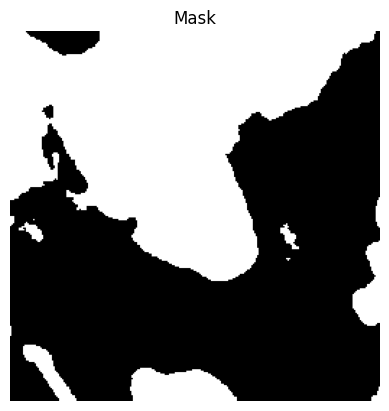

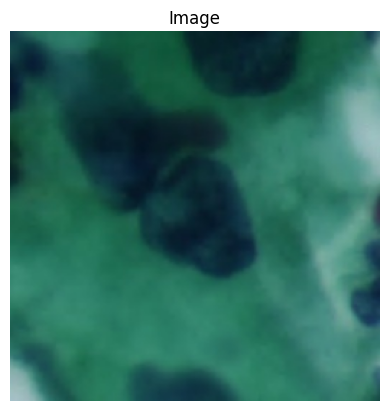

In [ ]:
# Checar se as máscaras estão identificando a parte necessária
# Carregar figura: center_0_2019_07_10__16_23__0048_b0s0c0x76363-1600y133912-1200m16917.png do conjunto val
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Ler imagem em RGB
img_path =  "/content/drive/MyDrive/RESULTADOS/mascaras_binarias_png/train/abnormal/center_6_2019_12_13__10_45__0038_b0s0c0x107200-1600y72000-1200m16867.png"
img_or = "/content/drive/MyDrive/RESULTADOS/nuclei_images_normalizadas_RGB/train/abnormal/center_6_2019_12_13__10_45__0038_b0s0c0x107200-1600y72000-1200m16867.jpg"
# Mascara
img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
# Imagem RGB
img_rgb = cv2.imread(img_or)

if img is not None:
    plt.imshow(img, cmap='gray')
    plt.title("Mask")
    plt.axis('off') # Hide axes
    plt.show()
else:
    print(f"Error loading mask image: {img_path}")
if img_rgb is not None:
    img_rgb = cv2.cvtColor(img_rgb, cv2.COLOR_BGR2RGB)
    plt.imshow(img_rgb)
    plt.title("Image")
    plt.axis('off') # Hide axes
    plt.show()
else:
    print(f"Error loading original image: {img_or}")

In [ ]:
import os
import cv2
import numpy as np
from tqdm import tqdm

# Caminho das máscaras segmentadas
caminho_mascaras =  "/content/drive/MyDrive/RESULTADOS/mascaras_binarias_png"
subsets = ['train', 'val', 'test']
classes = ['normal', 'abnormal']

def manter_maior_regiao(mascara_binaria):
    binaria = (mascara_binaria > 0).astype(np.uint8)
    num_labels, labels, stats, _ = cv2.connectedComponentsWithStats(binaria, connectivity=8)
    if num_labels <= 1:
        return mascara_binaria
    areas = stats[1:, cv2.CC_STAT_AREA]
    maior_indice = 1 + np.argmax(areas)
    resultado = (labels == maior_indice).astype(np.uint8) * 255
    return resultado.astype(np.uint8)

# Percorrer todas as máscaras
for subset in subsets:
    for classe in classes:
        pasta = os.path.join(caminho_mascaras, subset, classe)
        arquivos = [f for f in os.listdir(pasta) if f.endswith('.png')]

        for nome_arquivo in tqdm(arquivos, desc=f'Processando {subset}/{classe}'):
            caminho_img = os.path.join(pasta, nome_arquivo)

            # Carregar máscara
            mask = cv2.imread(caminho_img, cv2.IMREAD_GRAYSCALE)

            # Corrigir: manter só a maior região
            mask_corrigida = manter_maior_regiao(mask)

            # Salvar sobrescrevendo a anterior
            cv2.imwrite(caminho_img, mask_corrigida)


In [ ]:
# Extração de features:
import os
import cv2
import numpy as np
import pandas as pd
from skimage.measure import regionprops, label
from tqdm import tqdm

def extrair_features_morfologicas_mascara(mask, area_min=200):
    resultados = []
    labeled = label(mask)
    props = regionprops(labeled)

    unica_regiao = len(props) == 1

    for prop in props:
        # Se for a única região OU se área for maior que o mínimo, consideramos
        if unica_regiao or prop.area >= area_min:
            circ = (4 * np.pi * prop.area) / (prop.perimeter**2) if prop.perimeter > 0 else 0
            bbox_h = prop.bbox[2] - prop.bbox[0]
            bbox_w = prop.bbox[3] - prop.bbox[1]
            bbox_ratio = bbox_w / bbox_h if bbox_h > 0 else 0

            resultados.append({
                'area': prop.area,
                'perimetro': prop.perimeter,
                'circularidade': circ,
                'excentricidade': prop.eccentricity,
                'elongacao': prop.major_axis_length / prop.minor_axis_length if prop.minor_axis_length > 0 else 0,
                'compacidade': prop.area / (bbox_w * bbox_h) if bbox_w * bbox_h > 0 else 0,
                'bbox_ratio': bbox_ratio,
                'centroide_x': prop.centroid[0],
                'centroide_y': prop.centroid[1],
                'orientacao': prop.orientation,
                'euler_number': prop.euler_number
            })
    return resultados


# === CONFIGURAÇÕES ===
base_path = "/content/drive/MyDrive/RESULTADOS/mascaras_binarias_png"
subsets = ['train', 'val', 'test']
classes_desejadas = ['normal', 'abnormal']
area_min = 200

# === RESULTADO FINAL ===
todos_resultados = []

for subset in subsets:
    for classe in classes_desejadas:
        pasta_classe = os.path.join(base_path, subset, classe)
        if not os.path.exists(pasta_classe):
            continue

        for nome_arquivo in tqdm(os.listdir(pasta_classe), desc=f'{subset}/{classe}'):
            if nome_arquivo.lower().endswith(('.png', '.jpg', '.jpeg')):
                caminho = os.path.join(pasta_classe, nome_arquivo)
                mask = cv2.imread(caminho, cv2.IMREAD_GRAYSCALE)
                if mask is None:
                    continue
                # Binarizar caso necessário (assumindo que máscara é 0 e 255)
                bin_mask = (mask > 127).astype(np.uint8)
                features = extrair_features_morfologicas_mascara(bin_mask, area_min=area_min)
                for f in features:
                    f.update({
                        'nome_imagem': nome_arquivo,
                        'classe': classe,
                        'subset': subset
                    })
                    todos_resultados.append(f)

# Converter para DataFrame e salvar
df_final = pd.DataFrame(todos_resultados)
df_final.to_csv('/content/drive/MyDrive/RESULTADOS/features/features_morfologicas_normal_abnormal.csv', index=False)
print(" Extração finalizada. CSV salvo: features_morfologicas_normal_abnormal.csv")


test/abnormal: 100%|██████████| 3340/3340 [01:08<00:00, 48.73it/s]


 Extração finalizada. CSV salvo: features_morfologicas_normal_abnormal.csv


In [ ]:
import os
import cv2
import numpy as np
import pandas as pd
from tqdm import tqdm


# === CONFIGURAÇÕES ===
base_path =  "/content/drive/MyDrive/RESULTADOS/nuclei_images_normalizadas_RGB"
saida_path =  "/content/drive/MyDrive/RESULTADOS/EDA/histograma"
os.makedirs(saida_path, exist_ok=True)

subsets = ['train', 'val', 'test']
classes_desejadas = ['normal', 'abnormal']
bins = 256  # Resolução do histograma

def calcular_histograma_medio(caminhos_imgs):
    hist_r_total = np.zeros(bins)
    hist_g_total = np.zeros(bins)
    hist_b_total = np.zeros(bins)
    total_imgs = 0

    for path in tqdm(caminhos_imgs, desc='Calculando histogramas'):
        img = cv2.imread(path)
        if img is None:
            continue
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        chans = cv2.split(img)

        hist_r = cv2.calcHist([chans[0]], [0], None, [bins], [0, 256]).flatten()
        hist_g = cv2.calcHist([chans[1]], [0], None, [bins], [0, 256]).flatten()
        hist_b = cv2.calcHist([chans[2]], [0], None, [bins], [0, 256]).flatten()

        hist_r_total += hist_r
        hist_g_total += hist_g
        hist_b_total += hist_b
        total_imgs += 1

    if total_imgs == 0:
        return None

    return hist_r_total / total_imgs, hist_g_total / total_imgs, hist_b_total / total_imgs

# === PERCORRER CLASSES ===
for classe in classes_desejadas:
    caminhos_imgs = []
    for subset in subsets:
        pasta = os.path.join(base_path, subset, classe)
        if os.path.exists(pasta):
            arquivos = [os.path.join(pasta, f) for f in os.listdir(pasta) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
            caminhos_imgs.extend(arquivos)

    resultado = calcular_histograma_medio(caminhos_imgs)
    if resultado:
        hist_r, hist_g, hist_b = resultado
        df = pd.DataFrame({
            'Bin': np.arange(bins),
            'Canal_R': hist_r,
            'Canal_G': hist_g,
            'Canal_B': hist_b
        })
        df.to_csv(os.path.join(saida_path, f'{classe}_histograma_medio.csv'), index=False)
        print(f'Histograma médio salvo para classe {classe}')
    else:
        print(f'Nenhuma imagem válida para a classe {classe}')


Calculando histogramas: 100%|██████████| 8286/8286 [33:38<00:00,  4.11it/s]


Histograma médio salvo para classe normal


Calculando histogramas:  82%|████████▏ | 18601/22739 [4:08:36<53:49,  1.28it/s]  

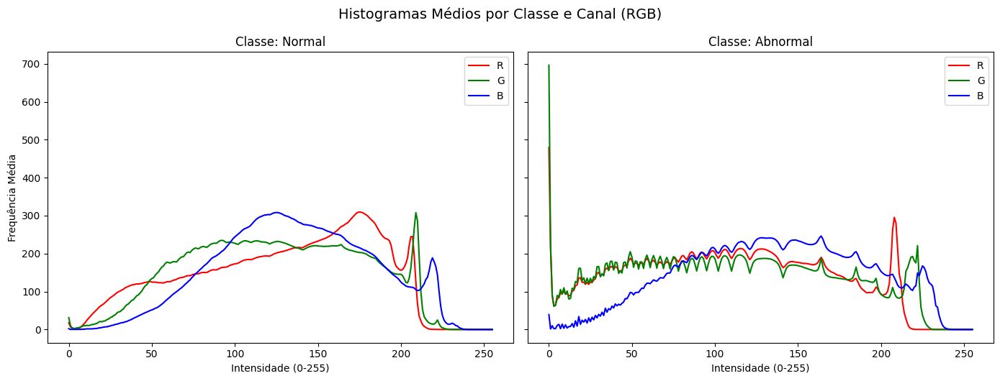

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import os

# Caminho para os arquivos CSV já extraídos com histogramas médios
normal_csv = "/content/drive/MyDrive/RESULTADOS/EDA/histograma/normal_histograma_medio.csv"
abnormal_csv = "/content/drive/MyDrive/RESULTADOS/EDA/histograma/abnormal_histograma_medio.csv"

# Carregar os dados
df_normal = pd.read_csv(normal_csv)
df_abnormal = pd.read_csv(abnormal_csv)

# Criar subplots: 1 linha, 2 colunas (normal e abnormal)
fig, axes = plt.subplots(1, 2, figsize=(14, 5), sharey=True)

# === Classe NORMAL ===
axes[0].plot(df_normal['Bin'], df_normal['Canal_R'], color='red', label='R')
axes[0].plot(df_normal['Bin'], df_normal['Canal_G'], color='green', label='G')
axes[0].plot(df_normal['Bin'], df_normal['Canal_B'], color='blue', label='B')
axes[0].set_title('Classe: Normal')
axes[0].set_xlabel('Intensidade (0-255)')
axes[0].set_ylabel('Frequência Média')
axes[0].legend()

# === Classe ABNORMAL ===
axes[1].plot(df_abnormal['Bin'], df_abnormal['Canal_R'], color='red', label='R')
axes[1].plot(df_abnormal['Bin'], df_abnormal['Canal_G'], color='green', label='G')
axes[1].plot(df_abnormal['Bin'], df_abnormal['Canal_B'], color='blue', label='B')
axes[1].set_title('Classe: Abnormal')
axes[1].set_xlabel('Intensidade (0-255)')
axes[1].legend()

plt.tight_layout()
plt.suptitle('Histogramas Médios por Classe e Canal (RGB)', y=1.05, fontsize=14)
plt.show()


In [ ]:
import os
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from plotly.offline import plot

# Criar a pasta no Drive
output_folder = '/content/drive/MyDrive/RESULTADOS/HISTOGRAMAS_RGB'
os.makedirs(output_folder, exist_ok=True)

# === Dados (assumindo df_normal e df_abnormal já carregados) ===
df_normal['classe'] = 'normal'
df_abnormal['classe'] = 'abnormal'
df = pd.concat([df_normal, df_abnormal], ignore_index=True)
df_long = pd.melt(df, id_vars=['Bin', 'classe'], value_vars=['Canal_R', 'Canal_G', 'Canal_B'],
                  var_name='canal', value_name='frequencia')
df_long['canal'] = df_long['canal'].str.replace('Canal_', '')
df_long.rename(columns={'Bin': 'bins'}, inplace=True)

# Criar o painel de histogramas
fig = make_subplots(rows=2, cols=3,
                    subplot_titles=[
                        "Normal - Canal R", "Normal - Canal G", "Normal - Canal B",
                        "Abnormal - Canal R", "Abnormal - Canal G", "Abnormal - Canal B"
                    ])
cores_canais = {'R': 'red', 'G': 'green', 'B': 'blue'}
classes = ['normal', 'abnormal']
canais = ['R', 'G', 'B']

for row_idx, classe in enumerate(classes, start=1):
    for col_idx, canal in enumerate(canais, start=1):
        df_sub = df_long[(df_long['classe'] == classe) & (df_long['canal'] == canal)]
        fig.add_trace(
            go.Bar(
                x=df_sub['bins'],
                y=df_sub['frequencia'],
                marker=dict(color=cores_canais[canal]),
                showlegend=False
            ),
            row=row_idx, col=col_idx
        )

fig.update_layout(
    title_text="Histograma RGB por Classe e Canal",
    width=1100,
    height=700,
    bargap=0.1
)

for i in range(1, 7):
    fig.update_xaxes(title_text="Intensidade (0-255)", row=(i-1)//3 +1, col=((i-1)%3)+1)
    fig.update_yaxes(title_text="Frequência", row=(i-1)//3 +1, col=((i-1)%3)+1)

fig.show()

# === Salvar como HTML no Drive ===
output_file = os.path.join(output_folder, 'histograma_rgb_painel.html')
plot(fig, filename=output_file, auto_open=False)
print(f"Gráfico HTML salvo em: {output_file}")


Gráfico HTML salvo em: /content/drive/MyDrive/RESULTADOS/HISTOGRAMAS_RGB/histograma_rgb_painel.html


Observa-se que os núcleos classificados como normais apresentaram distribuições espectrais mais suaves e concentradas, principalmente nos canais azul e verde. Por outro lado, as imagens da classe anormal evidenciaram maior dispersão e intensidade nos mesmos canais, com destaque para o canal verde. Essa variação espectral pode estar associada à presença de alterações morfológicas e estruturais típicas de lesões atípicas.

In [ ]:
print("Colunas df_normal:", df_normal.columns)
print("Colunas df_abnormal:", df_abnormal.columns)

Colunas df_normal: Index(['Bin', 'Canal_R', 'Canal_G', 'Canal_B', 'classe'], dtype='object')
Colunas df_abnormal: Index(['Bin', 'Canal_R', 'Canal_G', 'Canal_B', 'classe'], dtype='object')


# EDA - features morfológicas

In [ ]:
import pandas as pd
df = pd.read_csv("/content/drive/MyDrive/RESULTADOS/EDA/features/f_morfologicas_normal_abnormal.csv")
df.shape

(45911, 14)

In [ ]:
# area por conjunto de dados e classes
fig_area = px.box(
    df,
    x='classe',
    y='area',
    color='classe',
    facet_col='subset',
    color_discrete_map={'normal': 'skyblue', 'abnormal': 'lightcoral'},
    title='Distribuição da Área por Classe e Subset',
    points='outliers',
    height=500,
    width=1000
)
fig_area.update_layout(showlegend=False, boxmode='group')
fig_area.show()


In [ ]:
import matplotlib.pyplot as plt
# Salvar estatísticas descritivas como CSV
df.describe().to_csv("estat_morf.csv", index=True)
# Gerar estatísticas descritivas e transpor para deixar variáveis nas linhas
tabela_latex = df.describe().round(3)

# Salvar como arquivo LaTeX
with open("estat_morf.tex", "w") as f:
    f.write(tabela_latex.to_latex(
        float_format="%.3f",
        caption="Estatísticas descritivas das variáveis morfométricas.",
        label="tab:estat_morf"
    ))

In [ ]:
df.columns

Index(['area', 'perimetro', 'circularidade', 'excentricidade', 'elongacao',
       'compacidade', 'bbox_ratio', 'centroide_x', 'centroide_y', 'orientacao',
       'euler_number', 'nome_imagem', 'classe', 'subset'],
      dtype='object')

In [ ]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
area,45911.0,12018.341509,15110.821488,200.000000,1575.500000,3865.000000,21545.500000,63807.000000
perimetro,45911.0,528.402484,489.854046,49.798990,173.539105,284.403066,892.411255,3889.275575
circularidade,45911.0,0.520708,0.229403,0.026497,0.324331,0.518783,0.730136,1.020252
excentricidade,45911.0,0.724656,0.161078,0.052643,0.626822,0.746163,0.846325,0.998812
elongacao,45911.0,1.752927,0.889327,1.001389,1.283429,1.502035,1.877344,20.518581
compacidade,45911.0,0.668606,0.129203,0.124150,0.583681,0.690864,0.766493,0.986271
bbox_ratio,45911.0,1.129188,0.630787,0.075676,0.828125,1.000000,1.252476,14.000000
centroide_x,45911.0,96.621433,69.119782,1.491379,34.458421,83.705234,143.545416,253.341637
centroide_y,45911.0,96.598376,68.774914,1.978648,34.122697,85.221498,143.788463,253.609649
orientacao,45911.0,0.006324,0.940481,-1.570784,-0.813738,0.007689,0.827932,1.570791


Essas estatísticas descritivas revelam grande variabilidade morfométrica entre as regiões segmentadas. E por meio dessas informações nota-se que, a distribuição da área e do perímetro é assimétrica, com valores máximos que indicam a presença de possíveis outliers (células grandes ou agrupadas). A circularidade e compacidade sugerem uma predominância de formas moderadamente regulares, enquanto métricas como excentricidade e elongação apontam para núcleos com diferentes graus de alongamento.


In [ ]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Cores fixas para as classes
classes = ['normal', 'abnormal']
cores_classes = {'normal': '#D2691E', 'abnormal': '#4169E1'}  # Dark Orange e Royal Blue

# Criar a figura com 1 linha e 2 colunas
fig = make_subplots(
    rows=1, cols=2,
    subplot_titles=("Distribuição da Área por Classe", "Distribuição do Perímetro por Classe")
)

# === Gráfico da Área (coluna 1) ===
for classe in classes:
    fig.add_trace(
        go.Violin(
            y=df[df['classe'] == classe]['area'],
            x=[classe] * len(df[df['classe'] == classe]),
            name=f"{classe.capitalize()} (Área)",
            box_visible=True,
            meanline_visible=True,
            line_color='black',
            fillcolor=cores_classes[classe],
            opacity=0.6,
            points=False,
            showlegend=False
        ),
        row=1, col=1
    )

# === Gráfico do Perímetro (coluna 2) ===
for classe in classes:
    fig.add_trace(
        go.Violin(
            y=df[df['classe'] == classe]['perimetro'],
            x=[classe] * len(df[df['classe'] == classe]),
            name=f"{classe.capitalize()} (Perímetro)",
            box_visible=True,
            meanline_visible=True,
            line_color='black',
            fillcolor=cores_classes[classe],
            opacity=0.6,
            points=False,
            showlegend=False
        ),
        row=1, col=2
    )

# Ajustes de layout geral
fig.update_layout(
    width=1200,
    height=600,
    font=dict(size=14),
    plot_bgcolor='white',
    title_text="Comparativo: Área vs Perímetro por Classe",
)

# Ajuste de eixos
fig.update_yaxes(title_text="Área (pixels)", row=1, col=1)
fig.update_yaxes(title_text="Perímetro (pixels)", row=1, col=2)

fig.show()


Por meio desse gráfico violinplot combinado com boxplot pode-se perceber por meio desses gráficos que embora ambos apresentem assimetria à direita e outliers extremos, a classe anormal apresentou maior concentração de núcleos com áreas pequenas, mas também mais dispersão para valores altos, refletindo maior heterogeneidade morfológica. Já os núcleos normais mostraram distribuição mais concentrada, com áreas medianas ligeiramente maiores e menor frequência de valores extremos. Esses dados reforçam o que foi apresentado nas estatísticas descritivas. E variável perímetro apresenta comportamento muito semelhante entre as classes normal e anormal, com valores médios e máximos quase idênticos. Contudo, ambas as classes mostram assimetrias à direita e alta dispersão, com presença marcante de outliers. Isso indica que, embora o perímetro médio não diferencie as classes diretamente, a variabilidade e os extremos podem estar associados a alterações estruturais mais sutis, comuns em células anormais.

In [ ]:
import pandas as pd
import numpy as np

# Classes no dataset
classes = df['classe'].unique()
classes.sort()

# Lista para armazenar os resultados
estatisticas = []

for classe in classes:
    dados = df[df['classe'] == classe]['area'].values

    q1 = np.percentile(dados, 25)
    q2 = np.percentile(dados, 50)
    q3 = np.percentile(dados, 75)
    iqr = q3 - q1
    mean = np.mean(dados)
    min_val = np.min(dados)
    max_val = np.max(dados)
    upper_fence = q3 + 1.5 * iqr
    lower_fence = q1 - 1.5 * iqr

    estatisticas.append({
        'Classe': classe,
        'Min': round(min_val, 2),
        'Q1 (25%)': round(q1, 2),
        'Mediana (Q2)': round(q2, 2),
        'Média': round(mean, 2),
        'Q3 (75%)': round(q3, 2),
        'Max': round(max_val, 2),
        'Limite inferior': round(lower_fence, 2),
        'Limite superior': round(upper_fence, 2)
    })

# Criar DataFrame com os resultados
df_estatisticas = pd.DataFrame(estatisticas)

# Exportar para LaTeX
with open("tabela_estatisticas_area.tex", "w") as f:
    f.write(df_estatisticas.to_latex(index=False,
                                     caption="Estatísticas descritivas da variável área por classe.",
                                     label="tab:estatisticas_area",
                                     float_format="%.1f"))

In [ ]:
import pandas as pd
import numpy as np

# Classes no dataset
classes = df['classe'].unique()
classes.sort()

# Lista para armazenar os resultados
estatisticas = []

for classe in classes:
    dados = df[df['classe'] == classe]['perimetro'].values

    q1 = np.percentile(dados, 25)
    q2 = np.percentile(dados, 50)
    q3 = np.percentile(dados, 75)
    iqr = q3 - q1
    mean = np.mean(dados)
    min_val = np.min(dados)
    max_val = np.max(dados)
    upper_fence = q3 + 1.5 * iqr
    lower_fence = q1 - 1.5 * iqr

    estatisticas.append({
        'Classe': classe,
        'Min': round(min_val, 2),
        'Q1 (25%)': round(q1, 2),
        'Mediana (Q2)': round(q2, 2),
        'Média': round(mean, 2),
        'Q3 (75%)': round(q3, 2),
        'Max': round(max_val, 2),
        'Limite inferior': round(lower_fence, 2),
        'Limite superior': round(upper_fence, 2)
    })

# Criar DataFrame com os resultados
df_estatisticas = pd.DataFrame(estatisticas)

# Exportar para LaTeX
with open("tabela_estatisticas_perimetro.tex", "w") as f:
    f.write(df_estatisticas.to_latex(index=False,
                                     caption="Estatísticas descritivas da variável perímetro por classe.",
                                     label="tab:estatisticas_perimetro",
                                     float_format="%.1f"))

In [ ]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from scipy.stats import gaussian_kde

# Variáveis e classes
variaveis = ['compacidade', 'elongacao']
titulos = ['Compacidade', 'Elongação']
cores = {'normal': 'skyblue', 'abnormal': 'lightcoral'}
classes = df['classe'].unique()

# Subplots lado a lado
fig = make_subplots(rows=1, cols=2, subplot_titles=titulos)

for classe in classes:
    for i, var in enumerate(variaveis):
        dados = df[df['classe'] == classe][var].dropna()

        # Calcular densidade (KDE)
        kde = gaussian_kde(dados)
        x_vals = np.linspace(dados.min(), dados.max(), 500)
        y_vals = kde(x_vals)

        # Adicionar curva
        fig.add_trace(
            go.Scatter(
                x=x_vals,
                y=y_vals,
                mode='lines',
                name=classe,
                legendgroup=classe,  # Permite controle da legenda em ambos os subplots
                line=dict(color=cores[classe]),
                fill='tozeroy',
                opacity=0.4,
                showlegend=(i == 0)  # Mostrar legenda apenas no primeiro subplot
            ),
            row=1, col=i+1
        )

# Layout final
fig.update_layout(
    title_text="Distribuição de Densidade (KDE) - Compacidade e Elongação por Classe",
    width=1000,
    height=400
)

fig.update_xaxes(title_text='Compacidade', row=1, col=1)
fig.update_xaxes(title_text='Elongação', row=1, col=2)
fig.update_yaxes(title_text='Densidade', row=1, col=1)
fig.update_yaxes(title_text='Densidade', row=1, col=2)

fig.show()


In [ ]:
import numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from scipy.stats import gaussian_kde

# Variáveis e classes
variaveis = ['compacidade', 'elongacao']
titulos = ['Compacidade', 'Elongação']
cores = {'normal': '#D2691E', 'abnormal': '#4169E1'}
classes = df['classe'].unique()

# Criar subplots lado a lado
fig = make_subplots(rows=1, cols=2, subplot_titles=titulos)

# Adicionar curvas preenchidas + linhas de média + box de anotação
for classe in classes:
    for i, var in enumerate(variaveis):
        dados = df[df['classe'] == classe][var].dropna()
        kde = gaussian_kde(dados)
        x_vals = np.linspace(dados.min(), dados.max(), 500)
        y_vals = kde(x_vals)
        media = dados.mean()

        # Curva com preenchimento
        fig.add_trace(
            go.Scatter(
                x=x_vals,
                y=y_vals,
                mode='lines',
                name=classe,
                legendgroup=classe,
                fill='tozeroy',
                line=dict(color=cores[classe]),
                opacity=0.4,
                showlegend=(i == 0)
            ),
            row=1, col=i+1
        )

        # Linha de média tracejada
        fig.add_trace(
            go.Scatter(
                x=[media, media],
                y=[0, max(y_vals)],
                mode='lines',
                line=dict(color=cores[classe], dash='dash'),
                showlegend=False,
                hoverinfo='skip'
            ),
            row=1, col=i+1
        )

        # Anotação com caixa
        fig.add_annotation(
            x=media,
            y=max(y_vals) * 0.95,
            xref=f"x{i+1}",
            yref=f"y{i+1}",
            text=f"Média: {media:.2f}",
            showarrow=False,
            font=dict(color='white'),
            bgcolor=cores[classe],
            bordercolor='black',
            borderwidth=1,
            align='center',
            opacity=0.8
        )

# Layout final
fig.update_layout(
    title_text="Distribuição de Densidade (KDE) - Compacidade e Elongação por Classe",
    width=800,
    height=400
)

fig.update_xaxes(title_text='Compacidade', row=1, col=1)
fig.update_xaxes(title_text='Elongação', row=1, col=2)
fig.update_yaxes(title_text='Densidade', row=1, col=1)
fig.update_yaxes(title_text='Densidade', row=1, col=2)

fig.show()

Para análise complementar, foi plotado outras variáveis em duplas como compacidade e elongação. Essas variáveis indicam que células normais são mais compactas e arredondadas, enquanto células anormais apresentam formas mais variadas e ligeiramente mais alongadas.

In [ ]:
import plotly.express as px

# Apenas os dados de interesse
df_densidade = df[['circularidade', 'excentricidade', 'classe']].dropna()

# Criar gráfico com facet por classe
fig = px.density_contour(
    df_densidade,
    x="excentricidade",
    y="circularidade",
    color="classe",
    facet_col="classe",
    marginal_x="histogram",
    marginal_y="histogram",
    title="Distribuição 2D: Circularidade vs Excentricidade por Classe",
    height=500,
    width=1000
)

# Ajustar apenas as traces de contorno
fig.update_traces(selector=dict(type='contour'), contours_coloring="fill", opacity=0.6, showlegend=False)

# Ajustes visuais
fig.update_xaxes(matches=None, title='Excentricidade')
fig.update_yaxes(matches=None, title='Circularidade')
fig.update_layout(coloraxis_showscale=False)

fig.show()

Para circularidade e excentricidade, o plot acima revela que, para a classe normal, apresentou concentração de núcleos com alta circularidade e excentricidade moderada, refletindo contornos regulares. Já a classe anormal apresentou distribuição mais difusa, com menor circularidade e maior variação na excentricidade, indicando alterações estruturais típicas de células com atipias morfológicas.

In [ ]:
# 'bbox_ratio', 'centroide_x', 'centroide_y'

import plotly.graph_objects as go
from plotly.subplots import make_subplots

variaveis = ['bbox_ratio', 'centroide_x', 'centroide_y']
cores = {'normal': '#D2691E', 'abnormal': '#4169E1'}  # Dark Orange e Royal Blue
classes = df['classe'].unique()

# Subplots: 2 linhas (boxplot + histograma) e 3 colunas (variáveis)
fig = make_subplots(
    rows=2, cols=3,
    shared_xaxes=False,
    shared_yaxes='rows',
    row_heights=[0.3, 0.7],
    vertical_spacing=0.05,
    subplot_titles=[v.replace('_', ' ').capitalize() for v in variaveis]
)

# Plotagem
for i, var in enumerate(variaveis):
    for classe in classes:
        dados = df[df['classe'] == classe][var].dropna()

        # Boxplot (linha de cima)
        fig.add_trace(
            go.Box(
                x=dados,
                name=classe,
                marker_color=cores.get(classe, 'gray'),
                boxpoints=False,
                orientation='h',
                showlegend=(i == 0),  # mostrar legenda apenas na primeira coluna
                legendgroup=classe  # permite que a legenda filtre todas as colunas
            ),
            row=1, col=i+1
        )

        # Histograma (linha de baixo)
        fig.add_trace(
            go.Histogram(
                x=dados,
                name=classe,
                marker_color=cores.get(classe, 'gray'),
                opacity=0.6,
                nbinsx=50,
                showlegend=False,
                legendgroup=classe
            ),
            row=2, col=i+1
        )

# Layout final
fig.update_layout(
    height=500,
    width=1200,
    title_text="Distribuição das Variáveis bbox_ratio, centroide_x e centroide_y por Classe",
    barmode='overlay',
    legend_title="Classe"
)

# Eixos
for i, var in enumerate(variaveis):
    fig.update_xaxes(title_text=var.replace('_', ' ').capitalize(), row=2, col=i+1)
fig.update_yaxes(title_text="Frequência", row=2)

fig.show()


O plot apresenta a forma em que as variáveis bbbox\_ratio, x\_centroide e y\_centroide estão distribuídos. Ao analisar o comportamento dessas variáveis, por meio dos gráficos, nota-se que as células anormais tendem a ter bounding boxes mais assimétricas (formas mais alongadas ou inclinadas), enquanto as normais têm proporções mais regulares, pode ser percebido quando se analisa o histograma, e os Whiskers (boxplot) tando para normal como para anormal estão mais alongados, mais presente para núcleos anormais, o que indica maior variabilidade dos dados e outliers em que o valor máximo é 14. Em relação as variáveis centroide em x e centroide em y, apresentam distribuição bem similar, para a centroide em x a posição horizontal dos núcleos anormais tende a ser mais dispersa, possivelmente por serem mais numerosos ou por agrupamentos menos simétricos. Centroide em y possui um comportamento semelhante, em que localização vertical também confirma que núcleos anormais aparecem em regiões mais variadas da imagem, indicando maior irregularidade ou dispersão. Assim, a distribuição mais ampla e a assimetria das variáveis em anormal reforçam a heterogeneidade morfológica e espacial dos núcleos com alteração. Isso pode ser um forte sinal discriminativo para modelos de classificação, inclusive auxiliando em pré-processamentos.

In [ ]:
import pandas as pd
import numpy as np

# Variáveis que serão analisadas
variaveis = ['bbox_ratio', 'centroide_x', 'centroide_y']
classes = df['classe'].unique()

# Lista para armazenar os resultados
estatisticas = []

# Loop por classe e variável
for var in variaveis:
    for classe in classes:
        dados = df[df['classe'] == classe][var].dropna()

        estatisticas.append({
            'Variável': var,
            'Classe': classe,
            'Mín': round(np.min(dados), 2),
            'Q1': round(np.percentile(dados, 25), 2),
            'Mediana': round(np.median(dados), 2),
            'Média': round(np.mean(dados), 2),
            'Q3': round(np.percentile(dados, 75), 2),
            'Máx': round(np.max(dados), 2),
            'Desvio Padrão': round(np.std(dados), 2)
        })

# Criar DataFrame da tabela
df_estat = pd.DataFrame(estatisticas)

# Exportar para LaTeX
with open("tabela_estat_bbox_centroides.tex", "w") as f:
    f.write(df_estat.to_latex(index=False,
                               caption="Estatísticas descritivas das variáveis bbox_ratio, centroide_x e centroide_y por classe.",
                               label="tab:estat_bbox_centroides",
                               float_format="%.2f"))


# EDA - features de intensidade de coloração

In [ ]:
df_ie = pd.read_csv("/content/drive/MyDrive/RESULTADOS/EDA/features/f_esp_correta.csv")
df_ie.shape

(65521, 121)

In [ ]:
# localizar colunas que possuem nome com _hist_bin_ em qualquer parte
df_ie.filter(regex='_hist_bin_').columns

# Excluir colunas que contenha _hist_bin_
df_ie = df_ie.drop(df_ie.filter(regex='_hist_bin_').columns, axis=1)
df_ie.shape

(65521, 25)

In [ ]:
# Filtrar df para normal e abnormal
df_filt = df_ie[df_ie['classe'].isin(['normal', 'abnormal'])]
df_filt.shape

(31025, 25)

In [ ]:
df_filt.columns

Index(['conjunto', 'classe', 'nome_imagem', 'R_media', 'R_mediana', 'R_moda',
       'R_desvio', 'R_min', 'R_max', 'G_media', 'G_mediana', 'G_moda',
       'G_desvio', 'G_min', 'G_max', 'B_media', 'B_mediana', 'B_moda',
       'B_desvio', 'B_min', 'B_max', 'R_div_B', 'G_div_B', 'R_div_G',
       'RG_div_2B'],
      dtype='object')

In [ ]:
import plotly.express as px

df_box = df_filt.melt(
    id_vars='classe',
    value_vars=['R_media', 'R_mediana', 'R_moda', 'R_desvio', 'R_min', 'R_max'],
    var_name='Estatística',
    value_name='Valor'
)

fig = px.box(df_box, x='Estatística', y='Valor', color='classe', boxmode='group',
             title='Boxplot — Estatísticas do Canal R por Classe')
fig.update_layout(xaxis_title='Estatísticas de Intensidade de Coloração', yaxis_title='Valor')
fig.show()


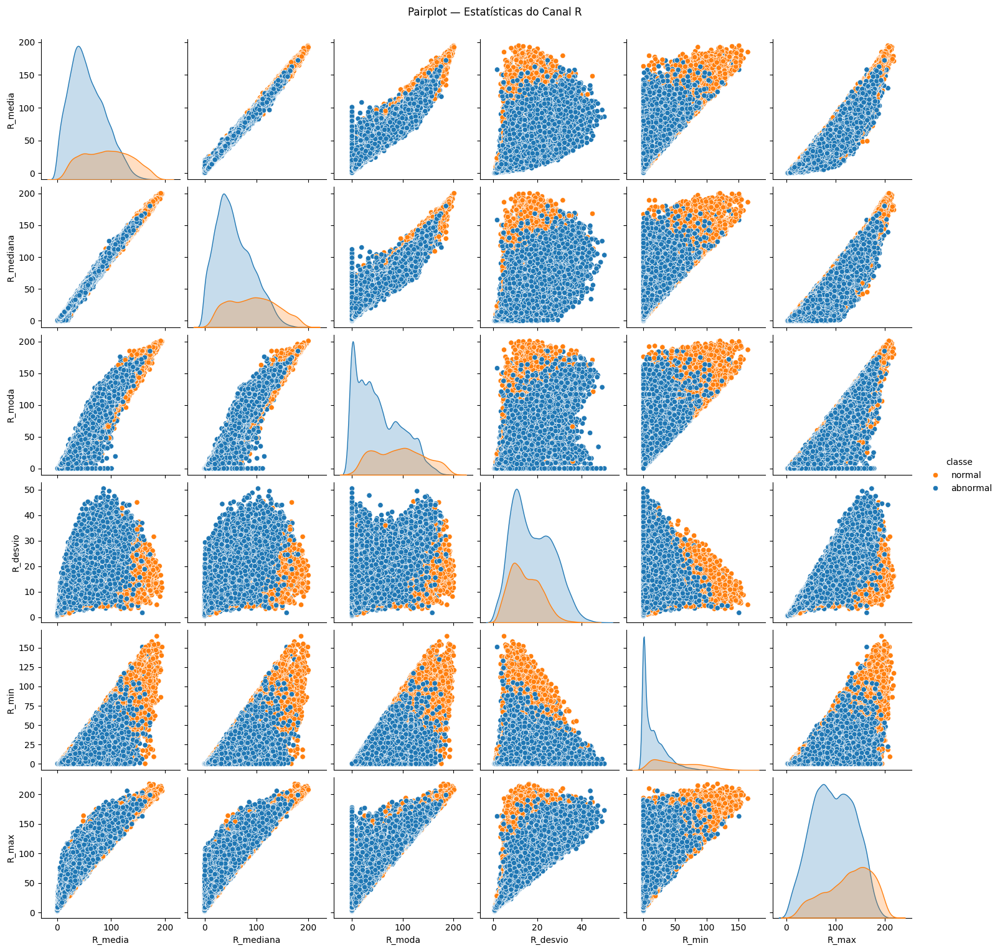

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Define cores personalizadas
palette = {
    "abnormal": "#1f77b4",  # azul
    "normal": "#ff7f0e"     # laranja
}

# Pairplot com cores invertidas
s= sns.pairplot(
    df_filt,
    vars=['R_media', 'R_mediana', 'R_moda', 'R_desvio', 'R_min', 'R_max'],
    hue='classe',
    palette=palette
)

plt.suptitle("Pairplot — Estatísticas do Canal R", y=1.02)
plt.show()


# Salvar como PNG
s.fig.savefig("pairplot_canal_R.png", dpi=300, bbox_inches='tight')

A Figura presenta a distribuição e o comportamento dos valores extraídos para o canal R (vermelho). Os gráficos de dispersão cruzada indicam que a classe anormal apresenta intensidade mais elevada em todas as métricas de tendência central (média, mediana, moda) e também nos extremos (mínimo e máximo), sugerindo que essas células são globalmente mais brilhantes no canal vermelho. A classe normal, por outro lado, está mais concentrada de valores baixos a médios, com maior variabilidade relativa no desvio padrão. Embora, a classe anormal apresente valores absolutos mais altos de desvio padrão, seus pontos estão mais concentrados, o que indica menor dispersão intraclasse. Já a classe normal tem pontos espalhados ao longo do eixo de desvio, refletindo heterogeneidade maior entre amostras.

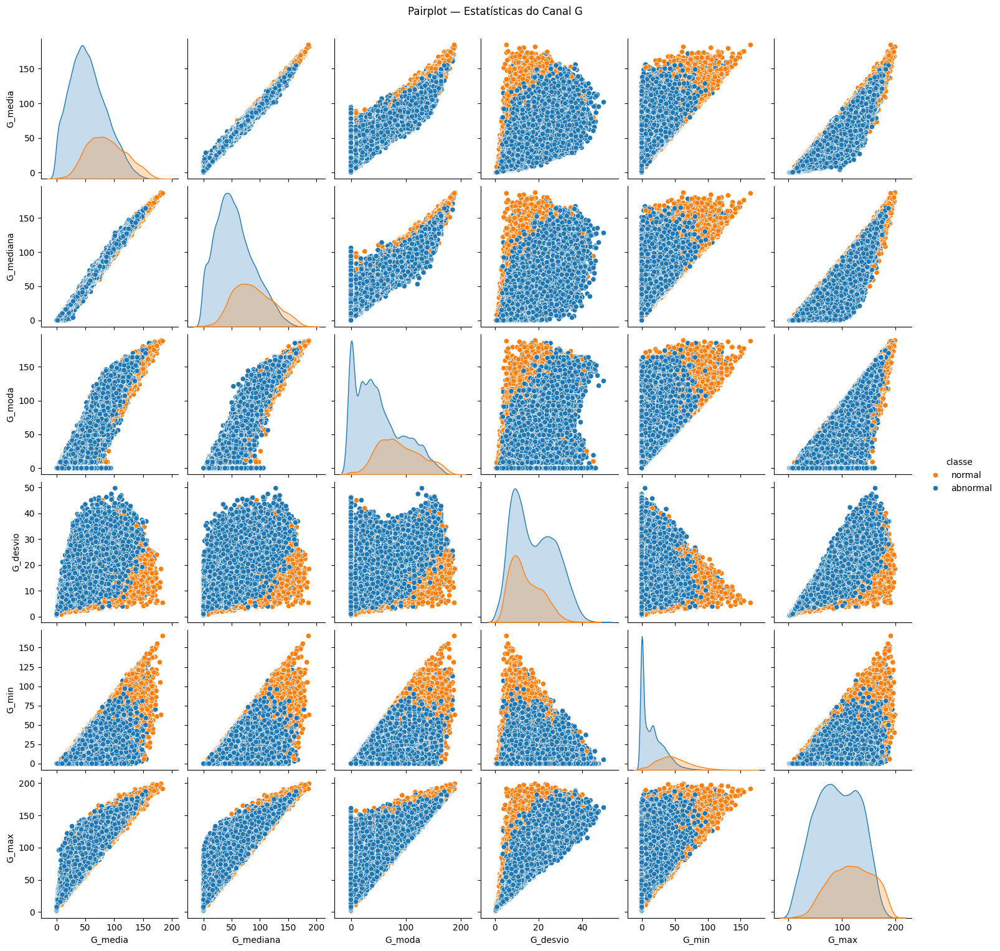

In [ ]:
# Define cores personalizadas
palette = {
    "abnormal": "#1f77b4",  # azul
    "normal": "#ff7f0e"     # laranja
}

# Pairplot com cores invertidas
r = sns.pairplot(
    df_filt,
    vars=['G_media', 'G_mediana', 'G_moda', 'G_desvio', 'G_min', 'G_max'],
    hue='classe',
    palette=palette
)

plt.suptitle("Pairplot — Estatísticas do Canal G", y=1.02)
plt.show()


# Salvar como PNG
r.fig.savefig("pairplot_canal_G.png", dpi=300, bbox_inches='tight')

 Ao analisar o pairplot referente ao canal G, as distribuições das estatísticas mostram diferenças relevantes entre as classes, porém com alta sobreposição nos pares de dispersão. A classe normal tende a apresentar distribuições mais concentradas e unicaudais, enquanto a classe anormal exibe distribuições mais amplas, com indícios de bicaudalidade ou multimodalidade em variáveis como moda, mínimo, máximo e desvio padão. O desequilíbrio de dados pode influenciar visualmente essas conclusões, uma vez que a maior quantidade de exemplos da classe anormal amplia a cauda e evidencia variações internas. Ainda assim, as tendências observadas sugerem que normal é mais restrita em intensidade e variação no canal G, ao passo que anormal exibe maior amplitude tonal e estrutural, embora haja sobreposição substancial entre os grupos.

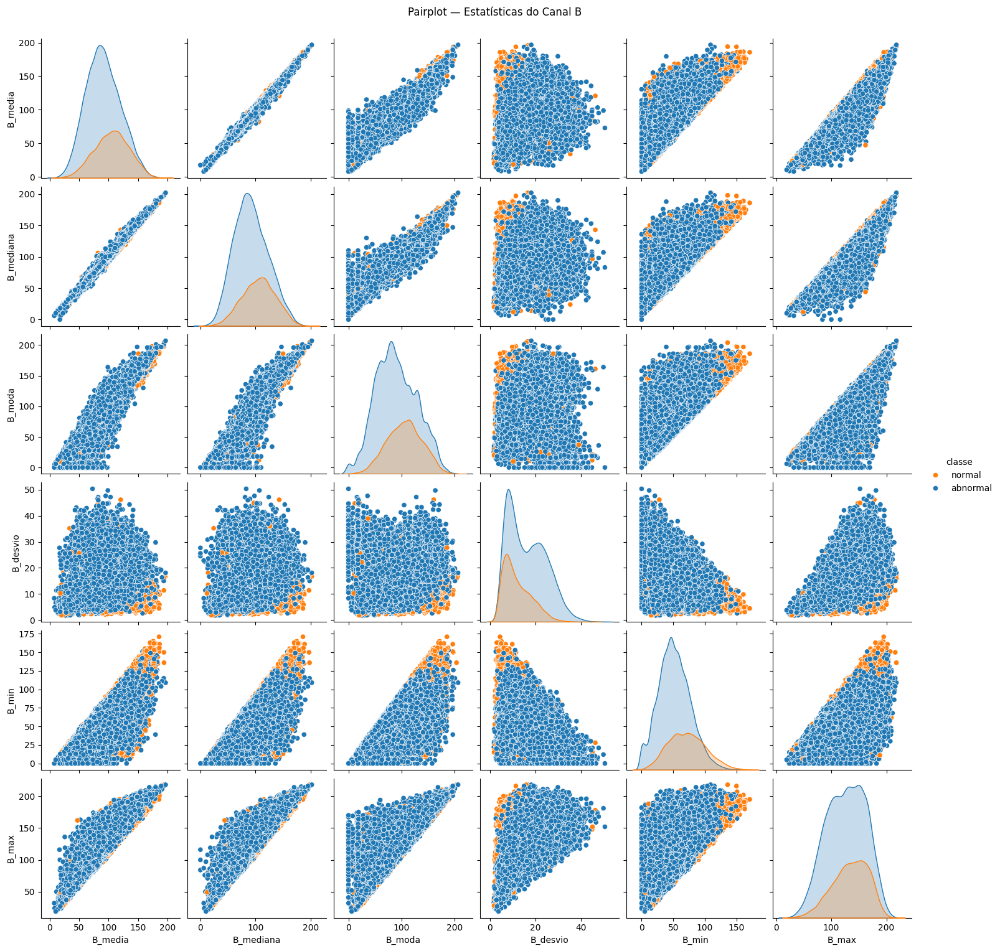

In [ ]:
# Define cores personalizadas
palette = {
    "abnormal": "#1f77b4",  # azul
    "normal": "#ff7f0e"     # laranja
}

# Pairplot com cores invertidas
g = sns.pairplot(
    df_filt,
    vars=['B_media', 'B_mediana', 'B_moda', 'B_desvio', 'B_min', 'B_max'],
    hue='classe',
    palette=palette
)

plt.suptitle("Pairplot — Estatísticas do Canal B", y=1.02)
plt.show()

# Salvar como PNG
g.fig.savefig("pairplot_canal_B.png", dpi=300, bbox_inches='tight')

# Exibir
plt.show()

 Para o canal B, as estatísticas de tendência central não promovem uma separação visual nítida entre as classes nos gráficos de dispersão. Os pontos de anormal se sobrepõem amplamente à distribuição de normal (pode ser explicada pela diferença de quantitativo nos conjuntos para as classes), indicando que ambas compartilham intervalos semelhantes de valores médios. No entanto, os gráficos de densidade revelam diferenças importantes: a classe normal possui distribuições mais simétricas e concentradas, em que quase todas são unicaudal e homogêneas, exceto por variável mínimo (min), que dá a impressão de ser bicaudal. Já anormal, mostra distribuição mais dispersa e assimétrica, com múltiplos picos, o que pode indicar variação estrutural intra-classe. Embora anormal alcance valores mais altos de intensidade azul, a separação não é acentuada nos pares de variáveis, reforçando que essas estatísticas devem ser complementadas por outras métricas para melhor diferenciação entre as classes.